# **Best Artworks of All Time**

### Inma Foulquié Mauser, Tassilo Schallenberg, Poulias Panagiotis, Utku Demir

# 0. Preliminaries

In this project we analyse the dataset "Best Artworks of all Time" available on kaggle, which consists of 8446 images of paintings from 50 different artists. Our goal is to build different models to predict the artist from a given painting – a classical multiclass image classification problem.

First we import the modules and functions we need. The two main libraries we will use in this project are the two go-to libraries for deep learning and neural networks: PyTorch and Keras.

In [9]:
# In case plotly figures don't work well
# !pip install nbformat 

# --- The usual suspects
import pandas as pd
import np
import gc
import json
import os

# -- Visualisation
import matplotlib.pyplot as plt
from matplotlib.ticker import FuncFormatter
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
pio.templates.default = "ggplot2"
%matplotlib inline


import tensorflow as tf
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import *
from tensorflow.keras.optimizers import *
from tensorflow.keras.applications import *
from tensorflow.keras.callbacks import *
from tensorflow.keras.initializers import *
from tensorflow.keras.preprocessing.image import ImageDataGenerator, img_to_array
import os







# --- Scikit
from sklearn.model_selection import train_test_split, GridSearchCV, RandomizedSearchCV
from sklearn.neighbors import KernelDensity
from sklearn.dummy import DummyClassifier

from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.ensemble import VotingClassifier
from sklearn.svm import SVC
from sklearn.svm import LinearSVR
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
from sklearn.model_selection import GridSearchCV
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.decomposition import PCA
from sklearn import preprocessing   # To try different scaling methods
import matplotlib.pyplot as plt
import pandas as pd 
import pickle
from sklearn.naive_bayes import GaussianNB
from xgboost import XGBClassifier
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.decomposition import TruncatedSVD
import plotly.express as px
import umap.umap_ as umap
UMAP = umap.UMAP
from sklearn.manifold import TSNE 
import plotly.express as px # for data visualization
from sklearn import datasets, cluster
from sklearn.feature_extraction.image import grid_to_graph
from sklearn import manifold
from sklearn.manifold import LocallyLinearEmbedding
from sklearn.decomposition import KernelPCA
from principal_feature_analysis import pfa
from sklearn.metrics import accuracy_score
from sklearn.metrics import balanced_accuracy_score
from sklearn.metrics import f1_score
from sklearn.metrics import top_k_accuracy_score
from sklearn.metrics import average_precision_score
	
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.metrics import classification_report



# --- PyTorch
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
from torch.utils.data import SubsetRandomSampler
from torchvision import datasets, models
import collections.abc as container_abcs
from torchvision import transforms as tr
from torchvision.datasets import ImageFolder

# --- Keras
import tensorflow as tf
from keras.preprocessing.image import ImageDataGenerator, img_to_array, image_dataset_from_directory
from keras.backend import clear_session
from keras.applications.inception_v3 import InceptionV3
from keras.preprocessing import image
from tensorflow.keras.preprocessing import image_dataset_from_directory
from keras.models import Model, load_model, Sequential
from keras.layers import Dense, GlobalAveragePooling2D
from keras.initializers import RandomNormal
from keras import backend as K
from keras.callbacks import Callback,ModelCheckpoint
from keras.wrappers.scikit_learn import KerasClassifier
from tensorflow.keras.optimizers import (SGD, Adam)
from tensorflow.keras.layers.experimental.preprocessing import Rescaling
from tensorflow.keras.utils import to_categorical
from keras.layers import (Conv2DTranspose, Activation, RandomRotation, RandomFlip, RandomZoom, 
                          AveragePooling2D, BatchNormalization, Conv2D, Conv2DTranspose,Dense, 
                          Dropout, Flatten,Input, MaxPool2D, LeakyReLU, ReLU, Reshape, 
                          UpSampling2D, GlobalAveragePooling2D, GaussianNoise)

# --- MISC.
from scipy.stats import uniform
from tqdm import tqdm, tqdm_notebook
import random



import warnings
warnings.filterwarnings('ignore')

# --- Palettes
con_palette = "agsunset" 
dis_palette = "Antique" 

seed = 1871

## Problem of Class Imbalance

It is important to note that the distribution of class is imbalanced. While 10.4% of the total number of paintings are paintings from Vincent Van Gogh, only 0.2% are from Jackson Pollock. The top 3 classes cover roughly 24% of the entire data. The following barplot shows the imbalanced distribution of classes. 

In [10]:
%%time
path_artists = '../00_data/artists.csv'
artists_df = pd.read_csv(path_artists)
artists_df.head()

CPU times: user 2.49 ms, sys: 1.12 ms, total: 3.62 ms
Wall time: 3.37 ms


,id,name,years,genre,nationality,bio,wikipedia,paintings
0,0,Amedeo Modigliani,1884 - 1920,Expressionism,Italian,Amedeo Clemente Modigliani (Italian pronunciat...,http://en.wikipedia.org/wiki/Amedeo_Modigliani,193
1,1,Vasiliy Kandinskiy,1866 - 1944,"Expressionism,Abstractionism",Russian,Wassily Wassilyevich Kandinsky (Russian: Васи́...,http://en.wikipedia.org/wiki/Wassily_Kandinsky,88
2,2,Diego Rivera,1886 - 1957,"Social Realism,Muralism",Mexican,Diego María de la Concepción Juan Nepomuceno E...,http://en.wikipedia.org/wiki/Diego_Rivera,70
3,3,Claude Monet,1840 - 1926,Impressionism,French,Oscar-Claude Monet (; French: [klod mɔnɛ]; 14 ...,http://en.wikipedia.org/wiki/Claude_Monet,73
4,4,Rene Magritte,1898 - 1967,"Surrealism,Impressionism",Belgian,René François Ghislain Magritte (French: [ʁəne...,http://en.wikipedia.org/wiki/René_Magritte,194


In [11]:
artists_df['percentage']=(artists_df['paintings'] / artists_df['paintings'].sum())
print("total number of paintings:", artists_df['paintings'].sum())
print("mean paintings per artists:", artists_df['paintings'].mean())
print("standard deviation:", round(artists_df['paintings'].std(),3))
print("maximum number of paintings:", artists_df['paintings'].max(), 
      round(artists_df['percentage'].max()*100,2), '%')
print("minimum number of paintings:", artists_df['paintings'].min(), 
      round(artists_df['percentage'].min()*100,2), '%')



artists_df_sorted = artists_df.sort_values('paintings', ascending=False)
fig = px.bar(artists_df_sorted
      , x="name"
      , y="percentage"
      , color='genre'
      #, barmode='group'
      , height=800
      , color_discrete_sequence=px.colors.qualitative.Antique
      )

fig.update_layout(barmode='stack', xaxis={'categoryorder':'total descending'})


total number of paintings: 8446
mean paintings per artists: 168.92
standard deviation: 157.451
maximum number of paintings: 877 10.38 %
minimum number of paintings: 24 0.28 %


## 1. Preprocessing

There are numerous articles about the optimal (See Blessing and 
Wen's *Using Machine Learning for Identification of Art Paintings* for regarding the effectiveness 
of a 100 $\cdot$ 100 format) format for image classification.
We are using a relatively more resource heavy but (hopefully) more effective resolution format 128 $\cdot$ 128 .

In [25]:
ImageHeight = 128
ImageWidth = 128
BatchSize = 103
Seed = seed

In [26]:
path_images = '../00_data/images/'

ds_original_sizes = ImageFolder(path_images)
ds = ImageFolder(path_images, transform=tr.Compose([tr.ToTensor(), tr.Resize((ImageHeight, ImageWidth))]))
dataset=image_dataset_from_directory(path_images,image_size=(128, 128), batch_size=BatchSize, shuffle=False)

artists=ds.classes
artists_dict=dict(zip(artists, range(50)))
artists_dict_inv=dict(zip(range(50), artists))

Found 8446 files belonging to 1 classes.


In [27]:
path_images = '../00_data/images/images/'

ds_original_sizes = ImageFolder(path_images)
ds = ImageFolder(path_images, transform=tr.Compose([tr.ToTensor(), tr.Resize((ImageHeight, ImageWidth))]))
dataset=image_dataset_from_directory(path_images,image_size=(128, 128), batch_size=BatchSize, shuffle=False)

artists=ds.classes
artists_dict=dict(zip(artists, range(50)))
artists_dict_inv=dict(zip(range(50), artists))

Found 8446 files belonging to 50 classes.


In [28]:
%%time
def resize_convert(data):
    return [img_to_array(data[i]) for i in range(len(data))]

X,y=[],[]
for batch,label in dataset:
    X+=resize_convert(batch)
    y+=list(label.numpy())

X=np.array(X)
X=X/255.
y=np.array(y)

Corrupt JPEG data: 12 extraneous bytes before marker 0xd9


CPU times: user 58.7 s, sys: 5.64 s, total: 1min 4s
Wall time: 11.9 s


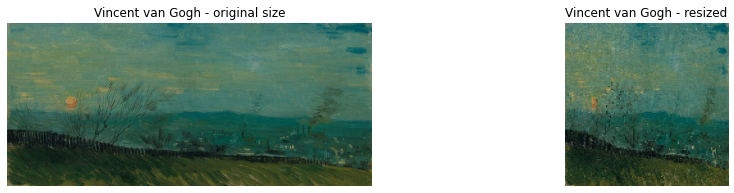

dimensions of resized images: [128, 128, 3]


In [16]:
#show example of resizing

fig, axes = plt.subplots(1, 2, figsize=(15,3))

axes[0].imshow(ds_original_sizes[7890][0])
axes[0].set_title(ds.classes[ds[7890][1]].replace("_", " ") + ' - original size')
axes[0].axis('off')
axes[1].imshow(ds[7890][0].permute(1,2,0))
axes[1].set_title(ds.classes[ds[7890][1]].replace("_", " ") + ' - resized')
axes[1].axis('off')
plt.show()

print('dimensions of resized images:', list(ds[0][0].permute(1,2,0).size()))

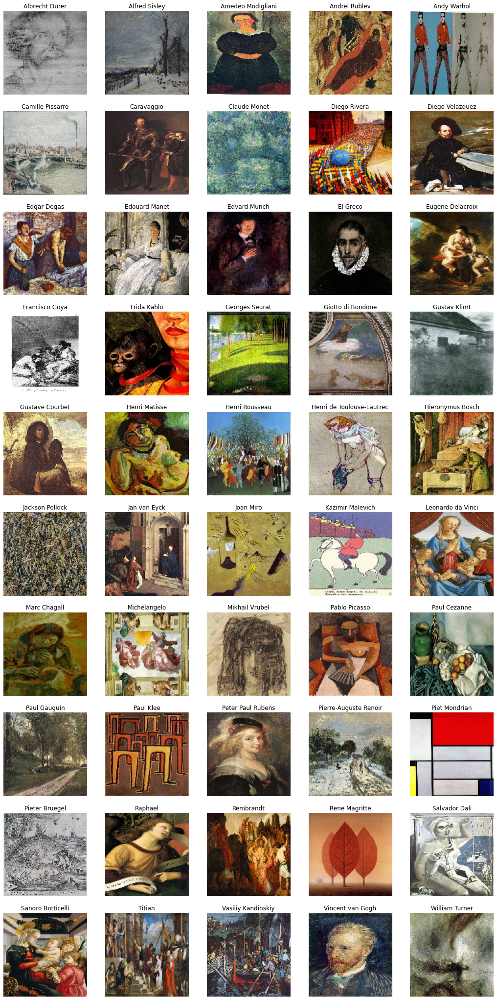

CPU times: user 2.43 s, sys: 776 ms, total: 3.2 s
Wall time: 2.42 s


In [17]:
%%time
# print some images
plt.figure(figsize=(18, 37))
for i in range(50):
    ax = plt.subplot(10,5,i+1)
    plt.imshow(ds[ds.targets.index(i)][0].permute(1,2,0))
    plt.title(ds.classes[i].replace("_", " "))
    plt.axis("off")
plt.show()

Corrupt JPEG data: 12 extraneous bytes before marker 0xd9


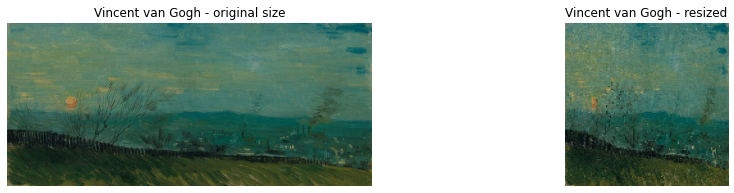

dimensions of resized images: [128, 128, 3]
CPU times: user 59.4 s, sys: 5.64 s, total: 1min 5s
Wall time: 12.5 s


In [18]:
%%time
def resize_convert(data):
    return [img_to_array(data[i]) for i in range(len(data))]

X,y=[],[]
for batch,label in dataset:
    X+=resize_convert(batch)
    y+=list(label.numpy())

X=np.array(X)
X=X/255.
y=np.array(y)
#show example of resizing

fig, axes = plt.subplots(1, 2, figsize=(15,3))

axes[0].imshow(ds_original_sizes[7890][0])
axes[0].set_title(ds.classes[ds[7890][1]].replace("_", " ") + ' - original size')
axes[0].axis('off')
axes[1].imshow(ds[7890][0].permute(1,2,0))
axes[1].set_title(ds.classes[ds[7890][1]].replace("_", " ") + ' - resized')
axes[1].axis('off')
plt.show()

print('dimensions of resized images:', list(ds[0][0].permute(1,2,0).size()))

### Mean Images

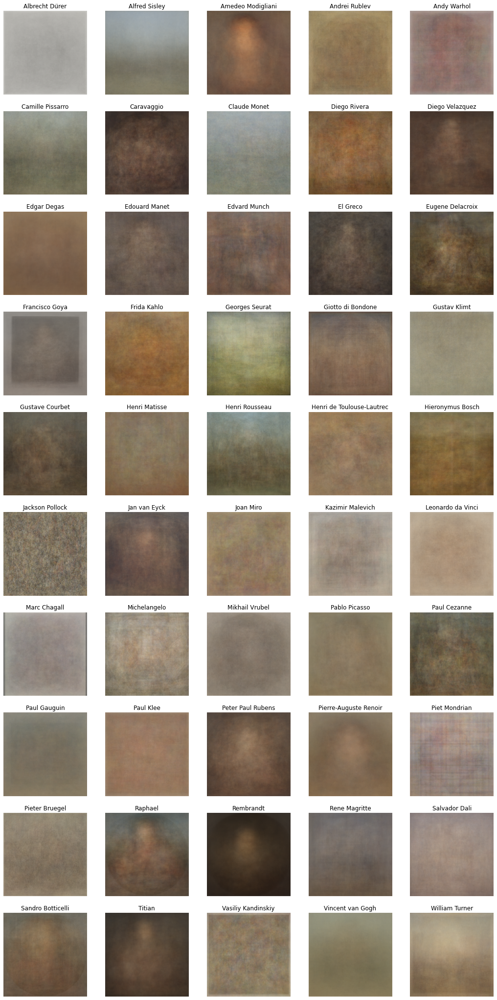

In [19]:
#mean images
mean_images=[np.zeros(X[0].shape)]*50
for i in range(50):
    indices = [idx for idx, el in enumerate(y) if el == i]
    for j in indices:
        mean_images[i]=X[j]+mean_images[i]
    mean_images[i]=mean_images[i]/len(indices)  
    
plt.figure(figsize=(18, 37))
for i in range(50):
    ax = plt.subplot(10,5,i+1)
    plt.imshow(mean_images[i])
    plt.title(ds.classes[i].replace("_", " "))
    plt.axis("off")
plt.show()

del dataset
del ds
del ds_original_sizes
del mean_images
clear_session()
gc.collect();

### Train-Test split

We are using a stratified seperation to combat the varying number of paintings from each artist. 

In [20]:
X_train, X_test, y_train, y_test = train_test_split(
    X,y, test_size = 0.2, shuffle=True, stratify=y, random_state=Seed)

del X
#del y

clear_session()
gc.collect();

In [21]:
#compare distribution of train and test using Kullback–Leibler divergence
from math import log2

y_dist=np.array([list(y).count(i) for i in range(50)])/len(y)
y_train_dist=np.array([list(y_train).count(i) for i in range(50)])/len(y_train)
y_test_dist=np.array([list(y_test).count(i) for i in range(50)])/len(y_test)

def kl_divergence(p, q):
    return sum(p[i] * log2(p[i]/q[i]) for i in range(len(p)))

kl1 = kl_divergence(y_train_dist, y_test_dist)
print('KL(Train || Test): %.3f bits' % kl1)
kl2 = kl_divergence(y_test_dist, y_train_dist)
print('KL(Test || Train): %.3f bits' % kl2)

KL(Train || Test): 0.000 bits
KL(Test || Train): 0.000 bits


## Data Augmentation

Adding some variation/rotation to the images is usually helpful in context of image recognition. Although it is mainly used for the recognition of "moving objects" we think we can especially help the training of CNNs with adata augmentation.

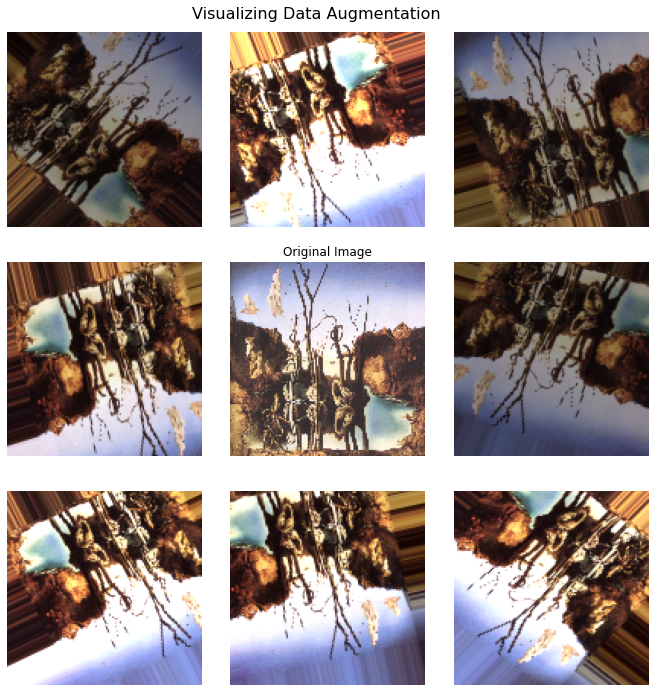

In [22]:
augmented_datagen = ImageDataGenerator(
    rotation_range=45,
    width_shift_range=0.1,
    height_shift_range=0.1,
    zoom_range=0.1,
    horizontal_flip=True,
    vertical_flip=True,
    fill_mode='nearest',
    brightness_range=[0.5,1.5],
    rescale=1/255.
)

train_augmented = augmented_datagen.flow(X_train, to_categorical(y_train), batch_size=BatchSize)

img = X_train[2607]
img_r = img.reshape((1,) + img.shape)
aug_img = augmented_datagen.flow(img_r, batch_size =1)

fig, axes = plt.subplots(3,3, figsize=(12, 12))
fig.suptitle("Visualizing Data Augmentation", fontsize=16, y=0.91)
fig.subplots_adjust(hspace = 0.18, wspace=0)
axes = axes.ravel()

for i in [x for x in range(9) if x != 4]:
    batch = aug_img.next()
    axes[i].imshow(batch[0])
    #axes[i].imshow(batch[0].astype('uint8'))
    axes[i].axis('off')
axes[4].imshow(img)
axes[4].set_title('Original Image')
axes[4].axis('off')
plt.show()

## Baseline Model

A dummy model generates a baseline for the further study, a completely random selection returns a barely succesful result.

In [23]:
print('accuracy of Dummy Classifier:')

clf = DummyClassifier(strategy='most_frequent', random_state=0)
clf.fit(X_train, y_train)
print('most_frequent: ', round(clf.score(X_test, y_test),3))

clf = DummyClassifier(strategy='stratified', random_state=0)
clf.fit(X_train, y_train)
print('stratified: ', round(clf.score(X_test, y_test),3))

clf = DummyClassifier(strategy='uniform', random_state=0)
clf.fit(X_train, y_train)
print('uniform: ', round(clf.score(X_test, y_test),3))

accuracy of Dummy Classifier:
most_frequent:  0.104
stratified:  0.037
uniform:  0.024


# 2. Dimensionality Reduction

Considering the enormous amount of features each painting contains, dimensionality reduction is almost a necessity in ourt case. We have tried to use this chance to benchmartk a variety of dimensionality reduction approaches. 

In [75]:
# Reshape the data for dimension reduction 
dim_train = np.shape(X_train)
dim_test = np.shape(X_test)

# Flatten the nested arrays for dimensionality red.
X_train_reshaped = np.reshape(X_train, (dim_train[0], dim_train[1]*dim_train[2]*3))
X_test_reshaped = np.reshape(X_test, (dim_test[0], dim_train[1]*dim_train[2]*3))



### Optimal number of components

In order to estimate the optimal amount of components in the usual dimensionalit reduction processes we have created a scree plot via a 1000 component PCA Model. Using "elbow method" we have decided to use 200 components (which explains 80% variance in the data) in our dim. reduction approaches other than with the models with specific n_component definitions.

In [95]:
exploratory_pca_model = PCA(n_components=1000
                            , random_state=seed
                            )
exploratory_X_train_pca = exploratory_pca_model.fit_transform(X_train_reshaped)


In [96]:

exp_pca_df = pd.DataFrame({"explained_variance":exploratory_pca_model.explained_variance_ratio_.cumsum()
            
})

In [97]:

fig = px.line(exp_pca_df
              , y="explained_variance"
              , title='Explained (cumulative) variance with respect to up to 1000 components'
              , height=800
              , color_discrete_sequence=px.colors.qualitative.Antique
              )
fig.update_xaxes(title_text='Number of Components')
fig.update_yaxes(title_text='Explained Variance')
fig.show()

a = '{0:.3g}'.format(exp_pca_df.loc[201,"explained_variance"]* 100)
print(f"200 componets are sufficient to explain {a}% of the variance")


200 componets are sufficient to explain 80.6% of the variance


In [31]:
n_comp = 200




CPU times: user 20 µs, sys: 1 µs, total: 21 µs
Wall time: 22.9 µs


### UMAP

In [77]:
%%time
""" UMAP """
umap = UMAP(n_components=n_comp
            , init='random'
            , random_state=seed
            )
X_train_umap = umap.fit_transform(X_train_reshaped)
X_test_umap = umap.fit_transform(X_test_reshaped)


CPU times: user 2min 52s, sys: 2.62 s, total: 2min 54s
Wall time: 1min 35s


In [78]:

fig_3d = px.scatter_3d(
    X_train_umap, x=0, y=1, z=2,
    color=y_train, labels={'color': 'painter'}
    , color_continuous_scale=con_palette
    
)
fig_3d.update_traces(marker_size=2)

fig_3d.show()



### T-SNE

In [80]:

%%time
""" T-SNE """
tsne = TSNE(n_components=3
            , random_state=seed)
X_train_tsne = tsne.fit_transform(X_train_reshaped )
X_test_tsne = tsne.fit_transform(X_test_reshaped )


CPU times: user 14min 9s, sys: 34.9 s, total: 14min 44s
Wall time: 2min 9s


In [81]:
fig = px.scatter_3d(
    X_train_tsne, x=0, y=1, z=2,
    color=y_train, labels={'color': 'painter'}
    , color_continuous_scale=con_palette
)
fig.update_traces(marker_size=5)
fig.show()

### Isomap

In [98]:
%%time
""" Isometric """
iso = manifold.Isomap(n_neighbors=10, n_components=n_comp)
X_train_isom = iso.fit(X_train_reshaped)
X_test_isom = iso.fit(X_test_reshaped)

X_train_isom = X_train_isom.transform(X_train_reshaped)
X_test_isom = X_test_isom.transform(X_test_reshaped)


CPU times: user 15min 26s, sys: 24 s, total: 15min 50s
Wall time: 2min 43s


In [99]:
fig = px.scatter_3d(
    X_train_isom, x=0, y=1, z=2,
    color=y_train, labels={'color': 'painter'}
    , color_continuous_scale=con_palette
)
fig.update_traces(marker_size=5)
fig.show()

### Principal Component Analysis

In [100]:
%%time
pca_model = PCA(n_components=n_comp, random_state=seed)

""" PCA """
X_train_pca = pca_model.fit_transform(X_train_reshaped)
X_test_pca = pca_model.fit_transform(X_test_reshaped)


CPU times: user 2min 35s, sys: 3.79 s, total: 2min 38s
Wall time: 21.8 s


In [101]:
fig = px.scatter_3d(
    X_train_pca, x=0, y=1, z=2,
    color=y_train, labels={'color': 'painter'}
    , color_continuous_scale=con_palette
)
fig.update_traces(marker_size=5)
fig.show()

### LLE

In [102]:
%%time
""" LLE """
X_train_lle = LocallyLinearEmbedding(n_components=n_comp, random_state=seed).fit_transform(X_train_reshaped)
X_test_lle = LocallyLinearEmbedding(n_components=n_comp, random_state=seed).fit_transform(X_test_reshaped)


CPU times: user 3min 10s, sys: 14 s, total: 3min 24s
Wall time: 39.9 s


In [103]:
fig = px.scatter_3d(
    X_train_lle, x=0, y=1, z=2,
    color=y_train, labels={'color': 'painter'}
    , color_continuous_scale=con_palette
)
fig.update_traces(marker_size=5)
fig.show()

### Kernel-PCA

In [104]:
%%time
""" Kernel-PCA """
rbf_pca = KernelPCA(n_components = n_comp, kernel="rbf")
X_train_kpca = rbf_pca.fit_transform(X_train_reshaped)
X_test_kpca = rbf_pca.fit_transform(X_test_reshaped)


CPU times: user 7min 34s, sys: 18.5 s, total: 7min 52s
Wall time: 1min 7s


In [105]:
fig = px.scatter_3d(
    X_train_kpca, x=0, y=1, z=2,
    color=y_train, labels={'color': 'painter'}
    , color_continuous_scale=con_palette
)
fig.update_traces(marker_size=5)
fig.show()

### Truncated SVD

In [106]:
%%time
""" Truncated SVD """
svd = TruncatedSVD(n_components=n_comp
                , random_state=seed)
X_train_svd = svd.fit_transform(X_train_reshaped)
X_test_svd = svd.fit_transform(X_test_reshaped)


CPU times: user 2min 20s, sys: 3.15 s, total: 2min 23s
Wall time: 20 s


In [107]:
fig = px.scatter_3d(
    X_train_svd, x=0, y=1, z=2,
    color=y_train, labels={'color': 'painter'}
    , color_continuous_scale=con_palette
)
fig.update_traces(marker_size=5)
fig.show()

### Principal Feature Analysis

A lesser known implementation based on PCA that focuses on eliminating features rather than their representation under a fewer dimensional space: 

http://venom.cs.utsa.edu/dmz/techrep/2007/CS-TR-2007-011.pdf

The 1-1 implementation of the PFA process did not work well with the data. Therefore, we are removing the implemetnation but leaving the algorithm as a knowledge gain in the research process.

In [35]:
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from collections import defaultdict
from sklearn.metrics.pairwise import euclidean_distances
from sklearn.preprocessing import StandardScaler

# A slightly altered version of the exact algorithm in the paper
class PFA(object):
    def __init__(self, n_features, q=None):
        self.q = q
        self.n_features = n_features

    def fit(self, X):
        if not self.q:
            self.q = min(X.shape[1], X.shape[0])

        sc = StandardScaler()
        X = sc.fit_transform(X)

        pca = PCA(n_components=self.q).fit(X)
        A_q = pca.components_.T

        kmeans = KMeans(n_clusters=self.n_features).fit(A_q)
        clusters = kmeans.predict(A_q)
        cluster_centers = kmeans.cluster_centers_

        dists = defaultdict(list)
        for i, c in enumerate(clusters):
            dist = euclidean_distances([A_q[i, :]], [cluster_centers[c, :]])[0][0]
            dists[c].append((i, dist))

        self.indices_ = [sorted(f, key=lambda x: x[1])[0][0] for f in dists.values()]
        self.features_ = X[:, self.indices_]

In [36]:
## %%time
## pfa = PFA(n_features=10)
## 
## pfa.fit(X_train_reshaped)
## X_train_pfa = pfa.features_
## 
## pfa.fit(X_test_reshaped)
## X_test_pfa = pfa.features_
## 
## column_indices = pfa.indices_

In [108]:
# """ Outputs """
# pickle.dump(X_train_umap, open("X_train_umap.p", "wb"))
# pickle.dump(X_train_tsne, open("X_train_tsne.p", "wb"))
# pickle.dump(X_train_isom, open("X_train_isom.p", "wb"))
# pickle.dump(X_train_pca,  open("X_train_pca.p" , "wb"))
# pickle.dump(X_train_kpca, open("X_train_kpca.p", "wb"))
# pickle.dump(X_train_lle,  open("X_train_lle.p" , "wb"))
# pickle.dump(X_train_svd,  open("X_train_svd.p" , "wb"))
# #pickle.dump(X_train_pfa,  open("X_train_pfa.p" , "wb"))

# pickle.dump(X_test_umap,  open("X_test_umap.p" , "wb"))
# pickle.dump(X_test_tsne,  open("X_test_tsne.p" , "wb"))
# pickle.dump(X_test_isom,  open("X_test_isom.p" , "wb"))
# pickle.dump(X_test_pca,   open("X_test_pca.p"  , "wb"))
# pickle.dump(X_test_kpca,  open("X_test_kpca.p" , "wb"))
# pickle.dump(X_test_lle,   open("X_test_lle.p"  , "wb"))
# pickle.dump(X_test_svd,   open("X_test_svd.p"  , "wb"))
# #pickle.dump(X_test_pfa,   open("X_test_pfa.p" , "wb"))



## Autoencoder

In [109]:
%%time
Encoder = Sequential([Input(shape=(128, 128, 3)),
                      Conv2D(16,(3,3),activation='relu',padding='same', kernel_initializer='he_normal'),  
                      MaxPool2D(2,padding='same'), 
                      Conv2D(8,(3,3),activation='relu',padding='same', kernel_initializer='he_normal'), 
                      MaxPool2D(2,padding='same'),
                      Conv2D(4,(3,3),activation='relu',padding='same', kernel_initializer='he_normal'), 
                      MaxPool2D(2,padding='same')
                      ])

Decoder = Sequential([Input(shape=(16, 16, 4)),
                      Conv2DTranspose(4,(3,3),activation='relu',padding='same', kernel_initializer='he_normal'),
                      UpSampling2D(2),
                      Conv2DTranspose(8,(3,3),activation='relu',padding='same', kernel_initializer='he_normal'),
                      UpSampling2D(2),
                      Conv2DTranspose(16,(3,3),activation='relu',padding='same', kernel_initializer='he_normal'),
                      UpSampling2D(2),
                      Conv2DTranspose(3,(3,3),activation='sigmoid',padding='same', kernel_initializer='he_normal')
                      ])

Autoencoder = Sequential([Encoder,Decoder])

Encoder.summary()
Decoder.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 128, 128, 16)      448       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 64, 64, 16)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 64, 64, 8)         1160      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 32, 32, 8)        0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 32, 32, 4)         292       
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 16, 16, 4)        0

In [110]:
Autoencoder.compile(optimizer='adam',loss='mean_squared_error')

In [111]:
%%time
aut_enco=Autoencoder.fit(X_train,X_train,epochs=10,verbose=1,validation_data=(X_test,X_test))
clear_session()
gc.collect();

Epoch 1/10
212/212 [==============================] - 22s 102ms/step - loss: 0.0422 - val_loss: 0.0256
Epoch 2/10
212/212 [==============================] - 23s 109ms/step - loss: 0.0220 - val_loss: 0.0204
Epoch 3/10
212/212 [==============================] - 22s 105ms/step - loss: 0.0194 - val_loss: 0.0194
Epoch 4/10
212/212 [==============================] - 21s 100ms/step - loss: 0.0183 - val_loss: 0.0179
Epoch 5/10
212/212 [==============================] - 22s 105ms/step - loss: 0.0176 - val_loss: 0.0175
Epoch 6/10
212/212 [==============================] - 22s 103ms/step - loss: 0.0171 - val_loss: 0.0184
Epoch 7/10
212/212 [==============================] - 22s 103ms/step - loss: 0.0168 - val_loss: 0.0167
Epoch 8/10
212/212 [==============================] - 22s 106ms/step - loss: 0.0164 - val_loss: 0.0163
Epoch 9/10
212/212 [==============================] - 22s 102ms/step - loss: 0.0161 - val_loss: 0.0163
Epoch 10/10
212/212 [==============================] - 22s 102ms/step - l

75871

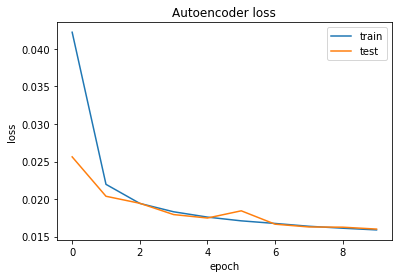

In [112]:
plt.plot(aut_enco.history['loss'])
plt.plot(aut_enco.history['val_loss'])
plt.title('Autoencoder loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper right')
plt.show()

In [113]:
X_train_en=Encoder.predict(X_train)
X_test_en=Encoder.predict(X_test)

X_train_de=Decoder.predict(X_train_en)
X_test_de=Decoder.predict(X_test_en)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


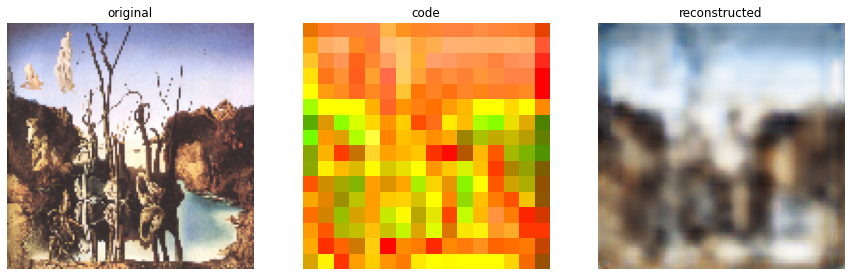

In [114]:
fig, axes = plt.subplots(1, 3, figsize=(15,5))

axes[0].imshow(X_train[2607])
axes[0].set_title('original')
axes[0].axis('off')
axes[1].imshow(X_train_en[2607])
axes[1].set_title('code')
axes[1].axis('off')
axes[2].imshow(X_train_de[2607])
axes[2].set_title('reconstructed')
axes[2].axis('off')
plt.show()

del aut_enco

clear_session()
gc.collect();

# 4. Conventional modelling approaches

An accuracy test method from the previous groups working on the same topic/dataset has been optimised to take different accuracy testing approaches into consideration:

In [116]:
def evaluate_model(label, m_model, X_train, X_test, y_train, y_test, mode=True):

    model = Pipeline([('scaler', StandardScaler()),
                    ('model', m_model)])

    model.fit(X_train, y_train)

    model_name_list = [
            "score",
            "balanced_accuracy_score",
            "f1_score",
            "top_k_accuracy_score",
            "average_precision_score",
        ]
    score_train = model.score(X_train, y_train)
    score_tests = []
    
    score_tests.append(model.score(X_test, y_test))
    score_tests.append(balanced_accuracy_score(model.predict(X_test), y_test))
    score_tests.append(f1_score(model.predict(X_test), y_test, average='micro'))

    print(f"\nModel {label}: ")
    print(f"\tTraining Accuracy: {score_train*100:.3f} %")
    for i,x in enumerate(score_tests):
        print(f"{model_name_list[i]}: {score_tests[i]*100:.3f} % ")
    mean_score = sum(score_tests)/len(score_tests)
    print(f"\tMEAN Accuracy: {(mean_score)*100:.3f} %\n")

    out = model
    return out

* A variety of classical machine learning approaches are selected to train a robust model. 

* A soft-voting calssifier will be used to mix all the applied methods at the bottom. 

* Because of the long training duration sthese models have been trained paralelly in individual python scrips and saved into pickle objects.

* The parameters of each modelling approach have been cross validated beforehand.

## K Nearest Neighbours

In [120]:
# Pre cross validated knn model
knn_model = pickle.load(open("knn_model.p", "rb"))
knn_model

KNeighborsClassifier(weights='distance')

In [121]:


#knn_model  = evaluate_model("umap_knn",knn_model, X_train_reshaped, X_test_reshaped, y_train, y_test)
knn_model_umap  = evaluate_model("umap_knn",knn_model, X_train_umap, X_test_umap, y_train, y_test)
knn_model_tsne  = evaluate_model("tsne_knn",knn_model, X_train_tsne, X_test_tsne, y_train, y_test)
knn_model_isom  = evaluate_model("isom_knn",knn_model, X_train_isom, X_test_isom, y_train, y_test)
knn_model_lle   = evaluate_model("lle _knn",knn_model, X_train_lle, X_test_lle, y_train, y_test  )
knn_model_svd   = evaluate_model("svd _knn",knn_model, X_train_svd, X_test_svd, y_train, y_test  )
knn_model_pca   = evaluate_model("pca _knn",knn_model, X_train_pca, X_test_pca, y_train, y_test  )
knn_model_kpca  = evaluate_model("kpca_knn",knn_model, X_train_kpca, X_test_kpca, y_train, y_test)



Model umap_knn: 
	Training Accuracy: 100.000 %
score: 4.970 % 
balanced_accuracy_score: 3.061 % 
f1_score: 4.970 % 
	MEAN Accuracy: 4.334 %


Model tsne_knn: 
	Training Accuracy: 100.000 %
score: 3.669 % 
balanced_accuracy_score: 1.096 % 
f1_score: 3.669 % 
	MEAN Accuracy: 2.811 %


Model isom_knn: 
	Training Accuracy: 100.000 %
score: 14.024 % 
balanced_accuracy_score: 7.731 % 
f1_score: 14.024 % 
	MEAN Accuracy: 11.926 %


Model lle _knn: 
	Training Accuracy: 100.000 %
score: 4.083 % 
balanced_accuracy_score: 1.903 % 
f1_score: 4.083 % 
	MEAN Accuracy: 3.356 %


Model svd _knn: 
	Training Accuracy: 100.000 %
score: 5.917 % 
balanced_accuracy_score: 2.223 % 
f1_score: 5.917 % 
	MEAN Accuracy: 4.686 %


Model pca _knn: 
	Training Accuracy: 100.000 %
score: 4.675 % 
balanced_accuracy_score: 1.858 % 
f1_score: 4.675 % 
	MEAN Accuracy: 3.736 %


Model kpca_knn: 
	Training Accuracy: 100.000 %
score: 3.964 % 
balanced_accuracy_score: 2.373 % 
f1_score: 3.964 % 
	MEAN Accuracy: 3.434 %



## Logistic Regression

In [123]:
""" Pre-cross-validated model """
log_model = pickle.load(open("log_model.p", "rb"))
log_model 

CPU times: user 503 µs, sys: 829 µs, total: 1.33 ms
Wall time: 1.04 ms


LogisticRegression(C=0.1, max_iter=5000, multi_class='multinomial',
                   solver='newton-cg')

In [124]:
%time

# log_model  =      evaluate_model(     "log", log_model, X_train_reshaped, X_test_reshaped, y_train, y_test)
log_model_umap  = evaluate_model("umap_log", log_model, X_train_umap, X_test_umap, y_train, y_test)
log_model_tsne  = evaluate_model("tsne_log", log_model, X_train_tsne, X_test_tsne, y_train, y_test)
log_model_isom  = evaluate_model("isom_log", log_model, X_train_isom, X_test_isom, y_train, y_test)
log_model_lle   = evaluate_model("lle _log", log_model, X_train_lle, X_test_lle, y_train, y_test  )
log_model_svd   = evaluate_model("svd _log", log_model, X_train_svd, X_test_svd, y_train, y_test  )
log_model_pca   = evaluate_model("pca _log", log_model, X_train_pca, X_test_pca, y_train, y_test  )
log_model_kpca  = evaluate_model("kpca_log", log_model, X_train_kpca, X_test_kpca, y_train, y_test)





CPU times: user 1 µs, sys: 1e+03 ns, total: 2 µs
Wall time: 3.81 µs

Model umap_log: 
	Training Accuracy: 17.644 %
score: 3.373 % 
balanced_accuracy_score: 1.725 % 
f1_score: 3.373 % 
	MEAN Accuracy: 2.824 %


Model tsne_log: 
	Training Accuracy: 14.772 %
score: 4.911 % 
balanced_accuracy_score: 3.473 % 
f1_score: 4.911 % 
	MEAN Accuracy: 4.432 %


Model isom_log: 
	Training Accuracy: 36.279 %
score: 14.734 % 
balanced_accuracy_score: 8.495 % 
f1_score: 14.734 % 
	MEAN Accuracy: 12.654 %


Model lle _log: 
	Training Accuracy: 29.618 %
score: 4.615 % 
balanced_accuracy_score: 2.346 % 
f1_score: 4.615 % 
	MEAN Accuracy: 3.859 %


Model svd _log: 
	Training Accuracy: 46.240 %
score: 8.994 % 
balanced_accuracy_score: 6.431 % 
f1_score: 8.994 % 
	MEAN Accuracy: 8.140 %


Model pca _log: 
	Training Accuracy: 46.181 %
score: 6.213 % 
balanced_accuracy_score: 3.041 % 
f1_score: 6.213 % 
	MEAN Accuracy: 5.156 %


Model kpca_log: 
	Training Accuracy: 51.317 %
score: 7.396 % 
balanced_accuracy_sc

## Random Forest Classifier

In [125]:
""" Pre-cross-validated model """
rfc_model = pickle.load(open("rfc_model.p", "rb"))
rfc_model 

RandomForestClassifier(bootstrap=False, max_depth=8, n_estimators=300,
                       random_state=42)

In [126]:
%time
""" Only RFS is to be ran with the original dataframe"""
# rfc_model  =      evaluate_model(     "rfc", rfc_model, X_train_reshaped, X_test_reshaped, y_train, y_test)
rfc_model_umap  = evaluate_model("umap_rfc", rfc_model, X_train_umap, X_test_umap, y_train, y_test)
rfc_model_tsne  = evaluate_model("tsne_rfc", rfc_model, X_train_tsne, X_test_tsne, y_train, y_test)
rfc_model_isom  = evaluate_model("isom_rfc", rfc_model, X_train_isom, X_test_isom, y_train, y_test)
rfc_model_lle   = evaluate_model("lle _rfc", rfc_model, X_train_lle, X_test_lle, y_train, y_test  )
rfc_model_svd   = evaluate_model("svd _rfc", rfc_model, X_train_svd, X_test_svd, y_train, y_test  )
rfc_model_pca   = evaluate_model("pca _rfc", rfc_model, X_train_pca, X_test_pca, y_train, y_test  )
rfc_model_kpca  = evaluate_model("kpca_rfc", rfc_model, X_train_kpca, X_test_kpca, y_train, y_test)




CPU times: user 1e+03 ns, sys: 1e+03 ns, total: 2 µs
Wall time: 3.1 µs

Model umap_rfc: 
	Training Accuracy: 31.898 %
score: 10.592 % 
balanced_accuracy_score: 10.522 % 
f1_score: 10.592 % 
	MEAN Accuracy: 10.569 %


Model tsne_rfc: 
	Training Accuracy: 33.911 %
score: 5.799 % 
balanced_accuracy_score: 0.885 % 
f1_score: 5.799 % 
	MEAN Accuracy: 4.161 %


Model isom_rfc: 
	Training Accuracy: 35.317 %
score: 17.160 % 
balanced_accuracy_score: 31.368 % 
f1_score: 17.160 % 
	MEAN Accuracy: 21.896 %


Model lle _rfc: 
	Training Accuracy: 30.995 %
score: 7.751 % 
balanced_accuracy_score: 5.416 % 
f1_score: 7.751 % 
	MEAN Accuracy: 6.973 %


Model svd _rfc: 
	Training Accuracy: 40.379 %
score: 14.497 % 
balanced_accuracy_score: 18.819 % 
f1_score: 14.497 % 
	MEAN Accuracy: 15.938 %


Model pca _rfc: 
	Training Accuracy: 39.654 %
score: 11.006 % 
balanced_accuracy_score: 11.751 % 
f1_score: 11.006 % 
	MEAN Accuracy: 11.254 %


Model kpca_rfc: 
	Training Accuracy: 39.935 %
score: 12.426 % 
bal

## SVM (sigmoid kernel)

In [127]:
""" Pre-cross-validated model """
svms_model = pickle.load(open("svms_model.p", "rb"))
svms_model 


SVC(C=0.1, gamma=0.1, kernel='sigmoid', probability=True)

In [128]:
%%time
svms_model_umap  = evaluate_model("umap_svms", svms_model, X_train_umap, X_test_umap, y_train, y_test)
svms_model_tsne  = evaluate_model("tsne_svms", svms_model, X_train_tsne, X_test_tsne, y_train, y_test)
svms_model_isom  = evaluate_model("isom_svms", svms_model, X_train_isom, X_test_isom, y_train, y_test)
svms_model_lle   = evaluate_model("lle _svms", svms_model, X_train_lle, X_test_lle, y_train, y_test  )
svms_model_svd   = evaluate_model("svd _svms", svms_model, X_train_svd, X_test_svd, y_train, y_test  )
svms_model_pca   = evaluate_model("pca _svms", svms_model, X_train_pca, X_test_pca, y_train, y_test  )
svms_model_kpca  = evaluate_model("kpca_svms", svms_model, X_train_kpca, X_test_kpca, y_train, y_test)





Model umap_svms: 
	Training Accuracy: 4.840 %
score: 3.077 % 
balanced_accuracy_score: 1.551 % 
f1_score: 3.077 % 
	MEAN Accuracy: 2.568 %


Model tsne_svms: 
	Training Accuracy: 13.410 %
score: 6.923 % 
balanced_accuracy_score: 4.191 % 
f1_score: 6.923 % 
	MEAN Accuracy: 6.012 %


Model isom_svms: 
	Training Accuracy: 7.031 %
score: 11.953 % 
balanced_accuracy_score: 11.762 % 
f1_score: 11.953 % 
	MEAN Accuracy: 11.889 %


Model lle _svms: 
	Training Accuracy: 9.443 %
score: 5.858 % 
balanced_accuracy_score: 4.307 % 
f1_score: 5.858 % 
	MEAN Accuracy: 5.341 %


Model svd _svms: 
	Training Accuracy: 11.190 %
score: 9.941 % 
balanced_accuracy_score: 5.143 % 
f1_score: 9.941 % 
	MEAN Accuracy: 8.342 %


Model pca _svms: 
	Training Accuracy: 10.983 %
score: 8.284 % 
balanced_accuracy_score: 4.111 % 
f1_score: 8.284 % 
	MEAN Accuracy: 6.893 %


Model kpca_svms: 
	Training Accuracy: 12.271 %
score: 9.231 % 
balanced_accuracy_score: 4.693 % 
f1_score: 9.231 % 
	MEAN Accuracy: 7.718 %

CPU t

## AdaBoost

In [132]:
""" Pre-cross-validated model """
ada_model = pickle.load(open("ada_model.p", "rb"))
ada_model 


AdaBoostClassifier(learning_rate=0.65, n_estimators=400)

In [133]:
%%time
ada_model_umap  = evaluate_model("umap_ada", ada_model, X_train_umap, X_test_umap, y_train, y_test)
ada_model_tsne  = evaluate_model("tsne_ada", ada_model, X_train_tsne, X_test_tsne, y_train, y_test)
ada_model_isom  = evaluate_model("isom_ada", ada_model, X_train_isom, X_test_isom, y_train, y_test)
ada_model_lle   = evaluate_model("lle _ada", ada_model, X_train_lle, X_test_lle, y_train, y_test  )
ada_model_svd   = evaluate_model("svd _ada", ada_model, X_train_svd, X_test_svd, y_train, y_test  )
ada_model_pca   = evaluate_model("pca _ada", ada_model, X_train_pca, X_test_pca, y_train, y_test  )
ada_model_kpca  = evaluate_model("kpca_ada", ada_model, X_train_kpca, X_test_kpca, y_train, y_test)






Model umap_ada: 
	Training Accuracy: 7.741 %
score: 3.136 % 
balanced_accuracy_score: 1.185 % 
f1_score: 3.136 % 
	MEAN Accuracy: 2.486 %


Model tsne_ada: 
	Training Accuracy: 4.381 %
score: 1.006 % 
balanced_accuracy_score: 1.564 % 
f1_score: 1.006 % 
	MEAN Accuracy: 1.192 %


Model isom_ada: 
	Training Accuracy: 12.211 %
score: 10.059 % 
balanced_accuracy_score: 3.206 % 
f1_score: 10.059 % 
	MEAN Accuracy: 7.775 %


Model lle _ada: 
	Training Accuracy: 12.700 %
score: 4.675 % 
balanced_accuracy_score: 5.101 % 
f1_score: 4.675 % 
	MEAN Accuracy: 4.817 %


Model svd _ada: 
	Training Accuracy: 13.292 %
score: 11.479 % 
balanced_accuracy_score: 4.573 % 
f1_score: 11.479 % 
	MEAN Accuracy: 9.177 %


Model pca _ada: 
	Training Accuracy: 13.470 %
score: 6.568 % 
balanced_accuracy_score: 5.169 % 
f1_score: 6.568 % 
	MEAN Accuracy: 6.102 %


Model kpca_ada: 
	Training Accuracy: 16.104 %
score: 11.302 % 
balanced_accuracy_score: 5.325 % 
f1_score: 11.302 % 
	MEAN Accuracy: 9.310 %

CPU times

## Gaussian Naive Bayes

In [134]:
%%time

gnb_model = pickle.load(open("gnb_model.p", "rb"))
gnb_model

CPU times: user 580 µs, sys: 1.15 ms, total: 1.73 ms
Wall time: 1.16 ms


GaussianNB(var_smoothing=0.0001)

In [135]:
%%time
gnb_model_umap  = evaluate_model("umap_gnb", gnb_model, X_train_umap, X_test_umap, y_train, y_test)
gnb_model_tsne  = evaluate_model("tsne_gnb", gnb_model, X_train_tsne, X_test_tsne, y_train, y_test)
gnb_model_isom  = evaluate_model("isom_gnb", gnb_model, X_train_isom, X_test_isom, y_train, y_test)
gnb_model_lle   = evaluate_model("lle _gnb", gnb_model, X_train_lle, X_test_lle, y_train, y_test  )
gnb_model_svd   = evaluate_model("svd _gnb", gnb_model, X_train_svd, X_test_svd, y_train, y_test  )
gnb_model_pca   = evaluate_model("pca _gnb", gnb_model, X_train_pca, X_test_pca, y_train, y_test  )
gnb_model_kpca  = evaluate_model("kpca_gnb", gnb_model, X_train_kpca, X_test_kpca, y_train, y_test)






Model umap_gnb: 
	Training Accuracy: 10.450 %
score: 3.432 % 
balanced_accuracy_score: 1.727 % 
f1_score: 3.432 % 
	MEAN Accuracy: 2.864 %


Model tsne_gnb: 
	Training Accuracy: 14.757 %
score: 4.970 % 
balanced_accuracy_score: 2.120 % 
f1_score: 4.970 % 
	MEAN Accuracy: 4.020 %


Model isom_gnb: 
	Training Accuracy: 20.411 %
score: 12.071 % 
balanced_accuracy_score: 9.459 % 
f1_score: 12.071 % 
	MEAN Accuracy: 11.200 %


Model lle _gnb: 
	Training Accuracy: 14.742 %
score: 5.385 % 
balanced_accuracy_score: 3.772 % 
f1_score: 5.385 % 
	MEAN Accuracy: 4.847 %


Model svd _gnb: 
	Training Accuracy: 35.539 %
score: 10.237 % 
balanced_accuracy_score: 6.873 % 
f1_score: 10.237 % 
	MEAN Accuracy: 9.115 %


Model pca _gnb: 
	Training Accuracy: 35.406 %
score: 7.456 % 
balanced_accuracy_score: 7.364 % 
f1_score: 7.456 % 
	MEAN Accuracy: 7.425 %


Model kpca_gnb: 
	Training Accuracy: 37.345 %
score: 8.698 % 
balanced_accuracy_score: 7.793 % 
f1_score: 8.698 % 
	MEAN Accuracy: 8.397 %

CPU time

## SVM

In [139]:
" Pre cross-validated model"
svm_model = pickle.load(open("svm_model.p", "rb"))
svm_model

SVC(C=1, gamma=0.1, probability=True)

In [140]:
%%time
svm_model_umap  = evaluate_model("umap_svm", svm_model, X_train_umap, X_test_umap, y_train, y_test)
svm_model_tsne  = evaluate_model("tsne_svm", svm_model, X_train_tsne, X_test_tsne, y_train, y_test)
svm_model_isom  = evaluate_model("isom_svm", svm_model, X_train_isom, X_test_isom, y_train, y_test)
svm_model_lle   = evaluate_model("lle _svm", svm_model, X_train_lle, X_test_lle, y_train, y_test  )
svm_model_svd   = evaluate_model("svd _svm", svm_model, X_train_svd, X_test_svd, y_train, y_test  )
svm_model_pca   = evaluate_model("pca _svm", svm_model, X_train_pca, X_test_pca, y_train, y_test  )
svm_model_kpca  = evaluate_model("kpca_svm", svm_model, X_train_kpca, X_test_kpca, y_train, y_test)






Model umap_svm: 
	Training Accuracy: 30.343 %
score: 10.414 % 
balanced_accuracy_score: 10.414 % 
f1_score: 10.414 % 
	MEAN Accuracy: 10.414 %


Model tsne_svm: 
	Training Accuracy: 16.859 %
score: 7.811 % 
balanced_accuracy_score: 3.231 % 
f1_score: 7.811 % 
	MEAN Accuracy: 6.284 %


Model isom_svm: 
	Training Accuracy: 93.236 %
score: 12.426 % 
balanced_accuracy_score: 34.189 % 
f1_score: 12.426 % 
	MEAN Accuracy: 19.680 %


Model lle _svm: 
	Training Accuracy: 96.078 %
score: 10.414 % 
balanced_accuracy_score: 10.414 % 
f1_score: 10.414 % 
	MEAN Accuracy: 10.414 %


Model svd _svm: 
	Training Accuracy: 99.970 %
score: 10.533 % 
balanced_accuracy_score: 30.219 % 
f1_score: 10.533 % 
	MEAN Accuracy: 17.095 %


Model pca _svm: 
	Training Accuracy: 99.970 %
score: 10.710 % 
balanced_accuracy_score: 40.943 % 
f1_score: 10.710 % 
	MEAN Accuracy: 20.788 %


Model kpca_svm: 
	Training Accuracy: 100.000 %
score: 10.414 % 
balanced_accuracy_score: 10.414 % 
f1_score: 10.414 % 
	MEAN Accuracy

## FITTING

In [141]:
%%time

model_list = [rfc_model,
              svm_model,
              knn_model,
              log_model,
              ada_model,
              gnb_model,
              svms_model
             # xgb_model
]
model_name_list = [ "Random Forest",
                    "Support Vector M.",
                    "K Neighbor Classifier",
                    "Logistic Reg.", 
                    "AdaBoost",
                    "Gaussian NB",
                    "SVM Sigmoid Kernel"
                    #"XGBoost"
                    ]


CPU times: user 3 µs, sys: 14 µs, total: 17 µs
Wall time: 18.1 µs


## VOTING CLASSIFIER


In [145]:
%%time
voting_clf = VotingClassifier ( estimators = list(zip(model_name_list, model_list)) ,
                                voting = 'soft'
                                # ,
                                # weights=[2, 4, 0, 4, 0, 3]
                                )

voting_clf.fit( X_train_pca , y_train )



CPU times: user 15min 47s, sys: 23.1 s, total: 16min 10s
Wall time: 4min 59s


VotingClassifier(estimators=[('Random Forest',
                              RandomForestClassifier(bootstrap=False,
                                                     max_depth=8,
                                                     n_estimators=300,
                                                     random_state=42)),
                             ('Support Vector M.',
                              SVC(C=1, gamma=0.1, probability=True)),
                             ('K Neighbor Classifier',
                              KNeighborsClassifier(weights='distance')),
                             ('Logistic Reg.',
                              LogisticRegression(C=0.1, max_iter=5000,
                                                 multi_class='multinomial',
                                                 solver='newton-cg')),
                             ('AdaBoost',
                              AdaBoostClassifier(learning_rate=0.65,
                                                 

In [146]:

y_pred = voting_clf.predict(X_test_pca)
voting_clf_score = accuracy_score(y_test, y_pred)
print(f"Accuracy score of the voting classifier = {voting_clf_score}")

Accuracy score of the voting classifier = 0.07928994082840236


In [147]:
voting_clf.predict(X_test_pca)
acc_scr = accuracy_score(y_test, y_pred)
print(f"Accuracy score of Voting Classifier = {acc_scr}")

Accuracy score of Voting Classifier = 0.07928994082840236


Conventional machine learning methods did not perform very well on the dataset. Voting classifier accuracy was extremely low. Although, different iterations yield better results compared with the CNN approaches the accuracy of the conventional models is limited.

# 5. CNN

Because Pytorch doesn't have existing implementations to train and access the loss/accuracy easily, we copied some auxiliary functions from [this Pytorch tutorial](https://pytorch.org/tutorials/beginner/finetuning_torchvision_models_tutorial.html) and modified them as needed.

In [1]:
#visualise training and get accuracy
def train_model(model, dataloaders, criterion, optimizer, num_epochs=5):
    since = time.time()
    
    train_acc_history = []
    val_acc_history = []
        
    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0

    for epoch in range(num_epochs):
        print('Epoch {}/{}'.format(epoch, num_epochs - 1))
        print('-' * 10)
        epoch_time = time.time()

        # Each epoch has a training and validation phase
        for phase in ['train', 'val']:
            if phase == 'train':
                model.train()  # Set model to training mode
            else:
                model.eval()   # Set model to evaluate mode

            running_loss = 0.0
            running_corrects = 0

            # Iterate over data.
            for inputs, labels in dataloaders[phase]:
                #inputs = inputs.to(device) # if you have GPU-access
                #labels = labels.to(device)

                # zero the parameter gradients
                optimizer.zero_grad()

                # forward
                # track history if only in train
                with torch.set_grad_enabled(phase == 'train'):
                    # Get model outputs and calculate loss
                    outputs = model(inputs)
                    loss = criterion(outputs, labels)

                    _, preds = torch.max(outputs, 1)

                    # backward + optimize only if in training phase
                    if phase == 'train':
                        loss.backward()
                        optimizer.step()

                # statistics
                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)

            epoch_loss = running_loss / len(dataloaders[phase].sampler) #dataloaders[phase].dataset
            epoch_acc = running_corrects.double() / len(dataloaders[phase].sampler) #dataloaders[phase].dataset
            epoch_elapsed = time.time() - epoch_time
            
            

            print('{} Loss: {:.4f} Acc: {:.4f}'.format(phase, epoch_loss, epoch_acc))
            if phase == 'train':
                train_acc_history.append(epoch_acc)

            # deep copy the model
            if phase == 'val' and epoch_acc > best_acc:
                best_acc = epoch_acc
                best_model_wts = copy.deepcopy(model.state_dict())
            if phase == 'val':
                val_acc_history.append(epoch_acc)

        print('Time needed: {:.0f}m {:.0f}s'.format(epoch_elapsed // 60, epoch_elapsed % 60))
        print()
        
    time_elapsed = time.time() - since
    print('Training complete in {:.0f}m {:.0f}s'.format(time_elapsed // 60, time_elapsed % 60))
    print('Best val Acc: {:4f}'.format(best_acc))

    # load best model weights
    model.load_state_dict(best_model_wts)
    return model, train_acc_history, val_acc_history

Convolutional Neural Networks have oftentimes the following scheme: 

Convolutional Layer (- Pooling Layer, optional but classic layer to implement)

Neurons are activated at a certain threshold (most popular and "basic" is the ReLU fct)

The last step should be a Linear transformation that connects all the Neurons together ('densly-connected neural network') and activated with "Softmax".

Because we are using Pytorch, we don't have to explicitly add this last activation layer as it is activated when calling the criterion for the optimising step. 

(also worth mentioning that with Pytorch, it is not necessary to one_hot encode the labels)

In [2]:
class Net(nn.Module):

    def __init__(self):
        super(Net, self).__init__()
        self.conv1 = nn.Conv2d(3, 16, 5)
        self.conv2 = nn.Conv2d(16, 32, 5)
        self.conv3 = nn.Conv2d(32, 128, 5)
        self.conv4 = nn.Conv2d(128, 256, 5)
        self.pool = nn.MaxPool2d(2,2)
        self.fc1 = nn.Linear(256 * 4 * 4, 1280)
        self.fc2 = nn.Linear(1280, 576)
        self.fc3 = nn.Linear(576, 50)
        self.activ1 = nn.ReLU()
        self.activ2 = nn.LeakyReLU()

    def forward(self, x):                        #let's track to what happens to the dimensions:
        x = self.pool(self.activ1(self.conv1(x))) #[batch_size, 3, 128, 128]-->[batch_size, 16, 62, 62]
        x = self.pool(self.activ2(self.conv2(x))) #[batch_size, 16, 62, 62]-->[batch_size, 32, 29, 29]
        x = self.pool(self.activ2(self.conv3(x))) #[batch_size, 32, 29, 29]-->[batch_size, 128, 12, 12]
        x = self.pool(self.activ2(self.conv4(x))) #[batch_size, 128, 12, 12]-->[batch_size, 256, 4, 4]
        x = torch.flatten(x, 1) # flatten all dimensions except the batch dimension : 256*3*3
        x = self.activ1(self.fc1(x))
        x = self.activ1(self.fc2(x))
        x = self.fc3(x)
        return x


net = Net()

NameError: name 'nn' is not defined

In [ ]:
#function to help apply certain weights to certain layers of the model
def init_weights(m):
    if isinstance(m, nn.Linear):
        torch.nn.init.kaiming_uniform_(m.weight.data) #kaiming is also called He initialization 
        m.bias.data.fill_(0.01)

In [ ]:
net.apply(init_weights)

criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(net.parameters(), lr=0.0002) #performed better than SGD
#net,train_hist,val_hist = train_model(net, dataloader, criterion, optimizer)

In [ ]:
'''plt.title('learning curve')
plt.plot(train_hist)
plt.plot(val_hist)
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train','test'])
plt.show()'''

"plt.title('learning curve')\nplt.plot(train_hist)\nplt.plot(val_hist)\nplt.ylabel('accuracy')\nplt.xlabel('epoch')\nplt.legend(['train','test'])\nplt.show()"

Unfortunatly, Pytorch is a library with runs very well on GPU but not on CPU. 
It takes a lot of time to train a model with the default Kaggle settings.
As we could only run 5 epochs, we cannot say much about the learning rate of our model. But based on our Keras models and on trainning behaviour observed, the accuracy could plateau on 36-40%: to futher better the model a scheduler can be set to change the learning rate as needed. (in Pytorch it should be implemented after the optimisation step)

## Mobilenetv2 Pytorch

In the following section, we finetuned a pre-existing model that is also already pre-trained.
It had promising results, unfortunatly it took to much time and used to much RAM. 
We prefered to omit the code, but still wanted to showcase our work.

In [ ]:
pt_model = "mobilenet"
feature_extract = True

In [ ]:
def initialize_model(model_name, feature_extract, num_classes=50, use_pretrained=True):
    # Initialize these variables which will be set in this if statement. Each of these variables is model specific.
    model_ft = None
    input_size = 0

    if model_name == "resnet":
        """ Resnet18
        """
        model_ft = models.resnet18(pretrained=use_pretrained)
        set_parameter_requires_grad(model_ft, feature_extract)
        num_ftrs = model_ft.fc.in_features
        model_ft.fc = nn.Linear(num_ftrs, num_classes)
        input_size = 224
        
    elif model_name == "mobilenet":
        """ MobileNetV2
        """
        model_ft = models.mobilenet_v2(pretrained=use_pretrained)
        set_parameter_requires_grad(model_ft, feature_extract)
        num_ftrs = model_ft.classifier[1].in_features
        model_ft.classifier[1] = nn.Linear(num_ftrs, num_classes)
        input_size = 224
        
  
    else:
        print("Invalid model name, exiting...")
        exit()

    return model_ft, input_size

In [ ]:
def set_parameter_requires_grad(model, feature_extracting):
    if feature_extracting:
        for param in model.parameters():
            param.requires_grad = False

In [ ]:
# Initialize the model for this run
model_ft, input_size = initialize_model(pt_model, feature_extract)

# Print the model we just instantiated
#print(model_ft)

Downloading: "https://download.pytorch.org/models/mobilenet_v2-b0353104.pth" to /Users/ubd/.cache/torch/hub/checkpoints/mobilenet_v2-b0353104.pth
100%|██████████| 13.6M/13.6M [00:01<00:00, 12.4MB/s]


In [ ]:
params_to_update = model_ft.parameters()
print("Params to learn:")
if feature_extract:
    params_to_update = []
    for name,param in model_ft.named_parameters():
        if param.requires_grad == True:
            params_to_update.append(param)
            print("\t",name)
else:
    for name,param in model_ft.named_parameters():
        if param.requires_grad == True:
            print("\t",name)

Params to learn:
	 classifier.1.weight
	 classifier.1.bias


In [ ]:
optimizer_ft = optim.SGD(params_to_update, lr=0.001, momentum=0.9)
optimizer2_ft = optim.Adam(params_to_update, lr=0.0002)
criterion = nn.CrossEntropyLoss()

#model_ft, hist,val_hist = train_model(model_ft, dataloader, criterion, optimizer_ft) 
#model_ft, hist, val_hist = train_model(model_ft, dataloader, criterion, optimizer2_ft)

In [ ]:
scratch_model,_ = initialize_model(pt_model, feature_extract=False, use_pretrained=False)
scratch_model.apply(init_weights)
scratch_optimizer = optim.SGD(scratch_model.parameters(), lr=0.001, momentum=0.9)
scratch_criterion = nn.CrossEntropyLoss()
#_,scratchtrain_hist,scratchtest_hist = train_model(scratch_model, dataloader, scratch_criterion, scratch_optimizer)

## Pretrained CNN with Keras

As Keras is very user friendly and has a vast library of pre-defined functions, we use it to furter experiment with pre-trained Models and see how layers and data augmentation impact the score.

In [136]:
y_train_onehot = to_categorical(y_train)
y_test_onehot = to_categorical(y_test)

In [31]:
#definition of f1 score (taken from old keras source code)
def get_f1(y_true, y_pred): 
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
    predicted_positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
    precision = true_positives / (predicted_positives + K.epsilon())
    recall = true_positives / (possible_positives + K.epsilon())
    f1_val = 2*(precision*recall)/(precision+recall+K.epsilon())
    return f1_val

In [ ]:
base_model = tf.keras.applications.MobileNet(
    weights='imagenet',
    include_top=False,
    input_shape=(128, 128, 3),
    classes=50
)

base_model.trainable = False

model = Sequential([
    base_model,
    GlobalAveragePooling2D(),
    Dense(512, kernel_initializer='he_uniform', activation='relu'),
    Dense(256, kernel_initializer='he_uniform', activation='relu'),
    BatchNormalization(),
    Dense(50, activation = 'softmax')
])

model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 mobilenet_1.00_128 (Functio  (None, 4, 4, 1024)       3228864   
 nal)                                                            
                                                                 
 global_average_pooling2d (G  (None, 1024)             0         
 lobalAveragePooling2D)                                          
                                                                 
 dense (Dense)               (None, 512)               524800    
                                                                 
 dense_1 (Dense)             (None, 256)               131328    
                                                                 
 batch_normalization (BatchN  (None, 256)              1024      
 ormalization)                                                   
                                                        

In [ ]:
model.compile(
    optimizer=Adam(learning_rate=0.0005),
    loss='categorical_crossentropy',
    metrics=['accuracy', get_f1]
)
 
history = model.fit(
    X_train,y_train_onehot,
    epochs=10,
    verbose=1,
    validation_data=(X_test,y_test_onehot)
)

Epoch 1/10
212/212 [==============================] - 22s 102ms/step - loss: 2.5101 - accuracy: 0.3851 - get_f1: 0.2715 - val_loss: 2.0406 - val_accuracy: 0.4734 - val_get_f1: 0.4299
Epoch 2/10
212/212 [==============================] - 21s 101ms/step - loss: 1.3549 - accuracy: 0.6409 - get_f1: 0.5718 - val_loss: 1.6500 - val_accuracy: 0.5533 - val_get_f1: 0.5230
Epoch 3/10
212/212 [==============================] - 21s 101ms/step - loss: 0.8924 - accuracy: 0.7716 - get_f1: 0.7266 - val_loss: 1.6226 - val_accuracy: 0.5763 - val_get_f1: 0.5583
Epoch 4/10
212/212 [==============================] - 21s 101ms/step - loss: 0.5194 - accuracy: 0.8834 - get_f1: 0.8479 - val_loss: 1.5724 - val_accuracy: 0.5876 - val_get_f1: 0.5676
Epoch 5/10
212/212 [==============================] - 21s 98ms/step - loss: 0.2632 - accuracy: 0.9562 - get_f1: 0.9412 - val_loss: 1.6914 - val_accuracy: 0.5728 - val_get_f1: 0.5760
Epoch 6/10
212/212 [==============================] - 21s 97ms/step - loss: 0.1206 - a

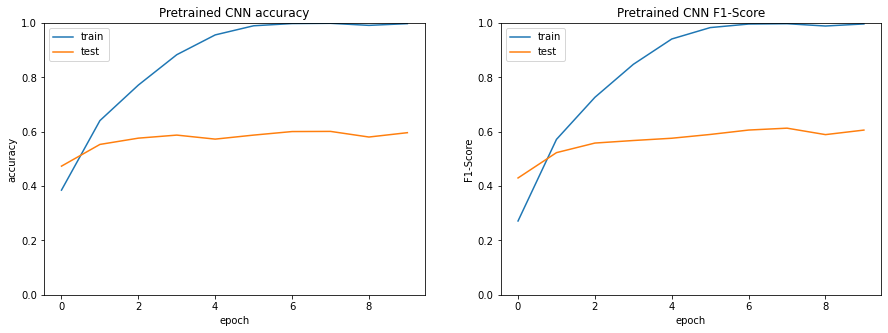

In [ ]:
fig, axes = plt.subplots(1, 2, figsize=(15,5))

axes[0].plot(history.history['accuracy'])
axes[0].plot(history.history['val_accuracy'])
axes[0].set_title('Pretrained CNN accuracy')
axes[0].set_ylabel('accuracy')
axes[0].set_xlabel('epoch')
axes[0].set_ylim([0, 1])
axes[0].legend(['train', 'test'], loc='upper left')
axes[1].plot(history.history['get_f1'])
axes[1].plot(history.history['val_get_f1'])
axes[1].set_title('Pretrained CNN F1-Score')
axes[1].set_ylabel('F1-Score')
axes[1].set_xlabel('epoch')
axes[1].set_ylim([0, 1])
axes[1].legend(['train', 'test'], loc='upper left')
plt.show()

In [ ]:
del history
del model

clear_session()
gc.collect();

In [ ]:
base_model = tf.keras.applications.MobileNet(
    weights='imagenet',
    include_top=False,
    input_shape=(128, 128, 3),
    classes=50
)

base_model.trainable = False

model = Sequential([
    base_model,
    GlobalAveragePooling2D(),
    Dense(512, kernel_initializer='he_uniform', activation='relu'),
    Dense(256, kernel_initializer='he_uniform', activation='relu'),
    BatchNormalization(),
    Dense(50, activation = 'softmax')
])

#model.summary()

In [ ]:
model.compile(
    optimizer=Adam(learning_rate=0.0005),
    loss='categorical_crossentropy',
    metrics=['accuracy', get_f1]
)
 
history = model.fit(
    train_augmented,
    epochs=10,
    verbose=1,
    validation_data=(X_test,y_test_onehot)
)

Epoch 1/10
66/66 [==============================] - 22s 324ms/step - loss: 3.0633 - accuracy: 0.2626 - get_f1: 0.1469 - val_loss: 2.7961 - val_accuracy: 0.3290 - val_get_f1: 0.2702
Epoch 2/10
66/66 [==============================] - 21s 318ms/step - loss: 2.1096 - accuracy: 0.4500 - get_f1: 0.3368 - val_loss: 2.1945 - val_accuracy: 0.4314 - val_get_f1: 0.3485
Epoch 3/10
66/66 [==============================] - 21s 318ms/step - loss: 1.8047 - accuracy: 0.5215 - get_f1: 0.4412 - val_loss: 2.0175 - val_accuracy: 0.4751 - val_get_f1: 0.4094
Epoch 4/10
66/66 [==============================] - 21s 317ms/step - loss: 1.6087 - accuracy: 0.5684 - get_f1: 0.4880 - val_loss: 1.9017 - val_accuracy: 0.5154 - val_get_f1: 0.4520
Epoch 5/10
66/66 [==============================] - 21s 319ms/step - loss: 1.4736 - accuracy: 0.6004 - get_f1: 0.5368 - val_loss: 1.7600 - val_accuracy: 0.5237 - val_get_f1: 0.4921
Epoch 6/10
66/66 [==============================] - 21s 313ms/step - loss: 1.3766 - accuracy: 0

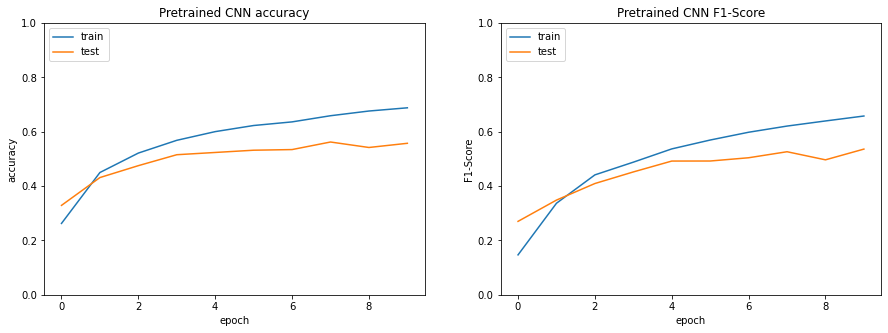

In [ ]:
fig, axes = plt.subplots(1, 2, figsize=(15,5))

axes[0].plot(history.history['accuracy'])
axes[0].plot(history.history['val_accuracy'])
axes[0].set_title('Pretrained CNN accuracy')
axes[0].set_ylabel('accuracy')
axes[0].set_xlabel('epoch')
axes[0].set_ylim([0, 1])
axes[0].legend(['train', 'test'], loc='upper left')
axes[1].plot(history.history['get_f1'])
axes[1].plot(history.history['val_get_f1'])
axes[1].set_title('Pretrained CNN F1-Score')
axes[1].set_ylabel('F1-Score')
axes[1].set_xlabel('epoch')
axes[1].set_ylim([0, 1])
axes[1].legend(['train', 'test'], loc='upper left')
plt.show() 

UnidentifiedImageError: cannot identify image file <_io.BytesIO object at 0x298c451d0>

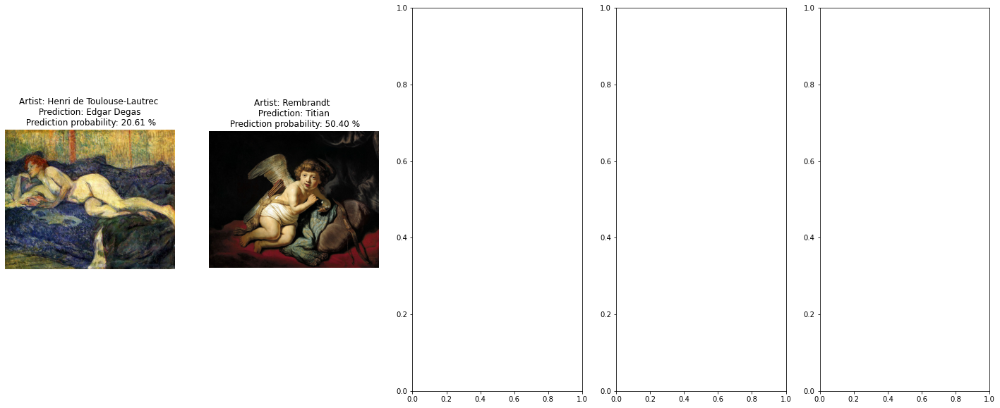

In [ ]:
#predict some images

np.random.seed(45678)

fig, axes = plt.subplots(1, 5, figsize=(25,10))

for i in range(5):
    rand_artist = np.random.choice(artists)
    rand_image = np.random.choice(os.listdir(os.path.join(path_images, rand_artist)))
    rand_image_file = os.path.join(path_images, rand_artist, rand_image)
    img = image.load_img(rand_image_file, target_size=(128,128,3))
    img = image.img_to_array(img)
    img /= 255.
    img = np.array([img])
    pred = model.predict(img)
    proba = np.amax(pred)
    pred_artist = artists_dict_inv[np.argmax(pred)]

    title = "Artist: {} \n Prediction: {} \n Prediction probability: {:.2f} %" \
                .format(rand_artist.replace('_', ' '), pred_artist.replace('_', ' '), proba*100)
    axes[i].imshow(plt.imread(rand_image_file))
    axes[i].set_title(title)
    axes[i].axis('off')
    
plt.show()

## Residual Neural Network, Resnet 50
Resnet is especially popular among the artwork classification process and it is often compared to the MobileNet structures. 

### ResNet 50 Model

In [193]:
r50_base_model = ResNet50(weights='imagenet'
                            , include_top=False
                            , input_shape=(128, 128, 3)
                            )

for layer in r50_base_model.layers:
    layer.trainable = True

# Resnet prep. and Layers
X_res = r50_base_model.output
# -> flatten
X_res = Flatten()(X_res)

X_res = Dense(1024, kernel_initializer='he_uniform')(X_res)
X_res =  BatchNormalization()(X_res)
X_res = Dense(512, kernel_initializer='he_uniform')(X_res)
X_res = BatchNormalization()(X_res)
X_res = Dense(256, kernel_initializer='he_uniform')(X_res)
X_res =  BatchNormalization()(X_res)
X_res = Dense(128, kernel_initializer='he_uniform')(X_res)
X_res = Activation('relu')(X_res)

resnet_output = Dense(artists_df.shape[0], activation='softmax')(X_res)
resnet_model = Model(inputs=r50_base_model.input, outputs=resnet_output)

#%%
TRAIN_DIR = '../00_data/images/images'
batch_size = 64
train_input_shape = (128, 128, 3)
n_classes = artists_df.shape[0]

#%%
optimizer = Adam(lr=0.0001)
resnet_model.compile(loss='categorical_crossentropy', optimizer=optimizer, metrics=['accuracy', get_f1])

n_epoch = 20    # would it perform better if we increase the number of epochs?
early_stop = EarlyStopping(monitor='val_loss', patience=20, verbose=1, 
                            mode='auto', restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=5, 
                            verbose=1, mode='auto')


resnet_history = resnet_model.fit(
    train_augmented,
    epochs=n_epoch,
    verbose=1,
    validation_data=(X_test,y_test_onehot),
    callbacks=[reduce_lr],
    shuffle=True
)



# Freeze core ResNet layers and train again 
for layer in resnet_model.layers:
    layer.trainable = False

for layer in resnet_model.layers[:50]:
    layer.trainable = True

optimizer = Adam(lr=0.0001)

resnet_model.compile(loss='categorical_crossentropy',
              optimizer=optimizer, 
              metrics=['accuracy'])


Epoch 1/20
66/66 [==============================] - 271s 4s/step - loss: 2.9385 - accuracy: 0.3028 - get_f1: 0.1994 - val_loss: 6.0937 - val_accuracy: 0.0201 - val_get_f1: 0.0000e+00 - lr: 1.0000e-04
Epoch 2/20
66/66 [==============================] - 258s 4s/step - loss: 1.8921 - accuracy: 0.5129 - get_f1: 0.4441 - val_loss: 5.9654 - val_accuracy: 0.0130 - val_get_f1: 0.0000e+00 - lr: 1.0000e-04
Epoch 3/20
66/66 [==============================] - 256s 4s/step - loss: 1.4886 - accuracy: 0.6070 - get_f1: 0.5439 - val_loss: 6.7715 - val_accuracy: 0.0284 - val_get_f1: 0.0197 - lr: 1.0000e-04
Epoch 4/20
66/66 [==============================] - 260s 4s/step - loss: 1.2473 - accuracy: 0.6604 - get_f1: 0.6239 - val_loss: 6.0140 - val_accuracy: 0.0172 - val_get_f1: 0.0104 - lr: 1.0000e-04
Epoch 5/20
66/66 [==============================] - 257s 4s/step - loss: 1.0224 - accuracy: 0.7208 - get_f1: 0.6929 - val_loss: 5.4244 - val_accuracy: 0.0166 - val_get_f1: 0.0000e+00 - lr: 1.0000e-04
Epoch 6/

UsageError: Line magic function `%%time` not found.


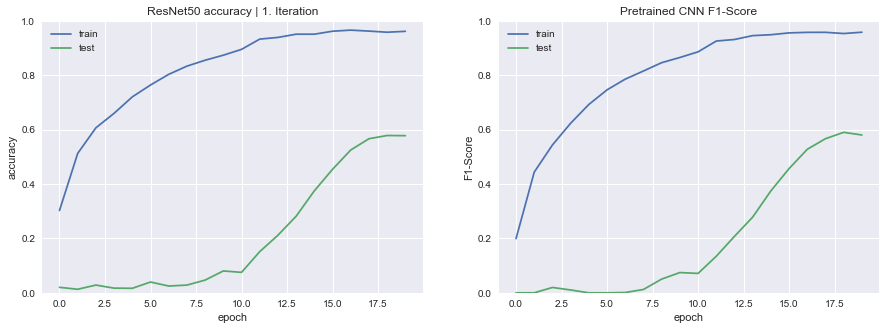

In [200]:
fig, axes = plt.subplots(1, 2, figsize=(15,5))

axes[0].plot(resnet_history.history['accuracy'])
axes[0].plot(resnet_history.history['val_accuracy'])
axes[0].set_title('ResNet50 accuracy | 1. Iteration')
axes[0].set_ylabel('accuracy')
axes[0].set_xlabel('epoch')
axes[0].set_ylim([0, 1])
axes[0].legend(['train', 'test'], loc='upper left')
axes[1].plot(resnet_history.history['get_f1'])
axes[1].plot(resnet_history.history['val_get_f1'])
axes[1].set_title('Pretrained CNN F1-Score')
axes[1].set_ylabel('F1-Score')
axes[1].set_xlabel('epoch')
axes[1].set_ylim([0, 1])
axes[1].legend(['train', 'test'], loc='upper left')
plt.show()

Unlike the MobileNet the accuracy of ResNet starts extremely low and does not raise rapidly until the 10. Epoch. However the model quickly reaches to ~60% accuracy with 20 epochs. The increment in terms of accuracy implicates the possiblity of further accuracy improvement with further iterartions.

In [198]:

n_epoch = 5 
history2 = resnet_model.fit(
    train_augmented,
    epochs=n_epoch,
    verbose=1,
    validation_data=(X_test,y_test_onehot),
    callbacks=[reduce_lr],
    shuffle=True
)







Epoch 1/5
66/66 [==============================] - 266s 4s/step - loss: 0.0939 - accuracy: 0.9812 - get_f1: 0.9789 - val_loss: 1.7827 - val_accuracy: 0.5911 - val_get_f1: 0.5967 - lr: 1.0000e-05
Epoch 2/5
66/66 [==============================] - 262s 4s/step - loss: 0.0976 - accuracy: 0.9812 - get_f1: 0.9791 - val_loss: 1.7228 - val_accuracy: 0.5947 - val_get_f1: 0.6016 - lr: 1.0000e-05
Epoch 3/5
66/66 [==============================] - 267s 4s/step - loss: 0.0899 - accuracy: 0.9824 - get_f1: 0.9810 - val_loss: 1.7718 - val_accuracy: 0.5982 - val_get_f1: 0.5985 - lr: 1.0000e-05
Epoch 4/5
66/66 [==============================] - 258s 4s/step - loss: 0.0830 - accuracy: 0.9852 - get_f1: 0.9840 - val_loss: 1.7656 - val_accuracy: 0.5953 - val_get_f1: 0.6011 - lr: 1.0000e-05
Epoch 5/5
66/66 [==============================] - 254s 4s/step - loss: 0.0803 - accuracy: 0.9865 - get_f1: 0.9846 - val_loss: 1.7948 - val_accuracy: 0.5911 - val_get_f1: 0.5902 - lr: 1.0000e-05


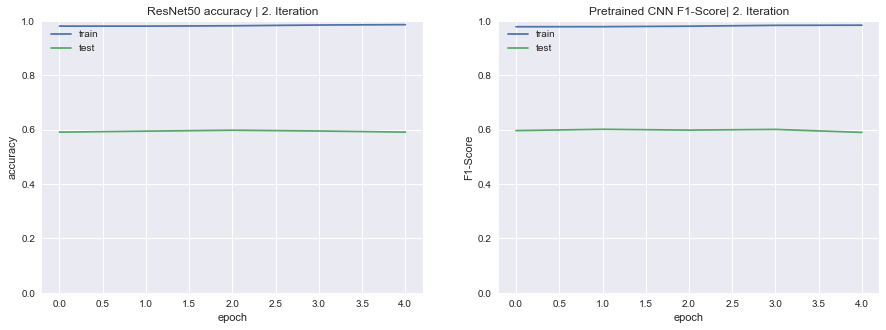

In [202]:
fig, axes = plt.subplots(1, 2, figsize=(15,5))

axes[0].plot(history2.history['accuracy'])
axes[0].plot(history2.history['val_accuracy'])
axes[0].set_title('ResNet50 accuracy | 2. Iteration')
axes[0].set_ylabel('accuracy')
axes[0].set_xlabel('epoch')
axes[0].set_ylim([0, 1])
axes[0].legend(['train', 'test'], loc='upper left')
axes[1].plot(history2.history['get_f1'])
axes[1].plot(history2.history['val_get_f1'])
axes[1].set_title('Pretrained CNN F1-Score| 2. Iteration')
axes[1].set_ylabel('F1-Score')
axes[1].set_xlabel('epoch')
axes[1].set_ylim([0, 1])
axes[1].legend(['train', 'test'], loc='upper left')
plt.show()

A 5 epoch long 2. iteration, however, does not seem to be creating much impact on the accuracy.

### Predict images with ResNet50

ResNet 60 has shown succes int the prediction accuracy, the following are a couple of ecamples how the ResNet model classifes  random paintigns from the dataset

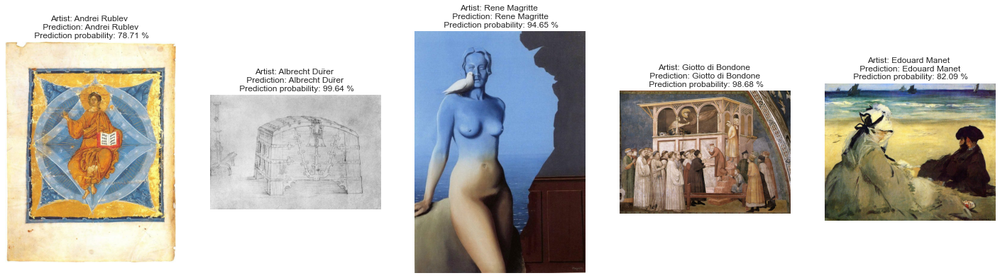

In [238]:
#predict some images

np.random.seed(1999)

fig, axes = plt.subplots(1, 5, figsize=(25,10))

for i in range(5):
    rand_artist = np.random.choice(artists)
    rand_image = np.random.choice(os.listdir(os.path.join(path_images, rand_artist)))
    rand_image_file = os.path.join(path_images, rand_artist, rand_image)
    img = image.load_img(rand_image_file, target_size=(128,128,3))
    img = image.img_to_array(img)
    img /= 255.
    img = np.array([img])
    pred = resnet_model.predict(img)
    proba = np.amax(pred)
    pred_artist = artists_dict_inv[np.argmax(pred)]

    title = "Artist: {} \n Prediction: {} \n Prediction probability: {:.2f} %" \
                .format(rand_artist.replace('_', ' '), pred_artist.replace('_', ' '), proba*100)
    axes[i].imshow(plt.imread(rand_image_file))
    axes[i].set_title(title)
    axes[i].axis('off')
    
plt.show()



# Prediction of other paintings

In [33]:
resnet_model = load_model("model_resnet3", custom_objects={'get_f1': get_f1})

Another approach is to look at models accuracy on the paintings outside of the dataset.

In [186]:
""" A painting from William Turner"""
new_img_turn = '../00_data/random_artwork/ART/Joseph Mallord William Turner.jpg'

""" A painting from Van Gogh"""
new_img_gogh = '../00_data/random_artwork/ART/vincent_van_gogh_-_portrait_of_joseph-michel_ginoux_1888_65x54_5cm_kroller-muller_museum.jpg'

""" A painting from Albrecht Dürer"""
new_img_dure = '../00_data/random_artwork/ART/albrecht-durer-self-portrait-at-age-22-1493-trivium-art-history.jpg'

plt.show()

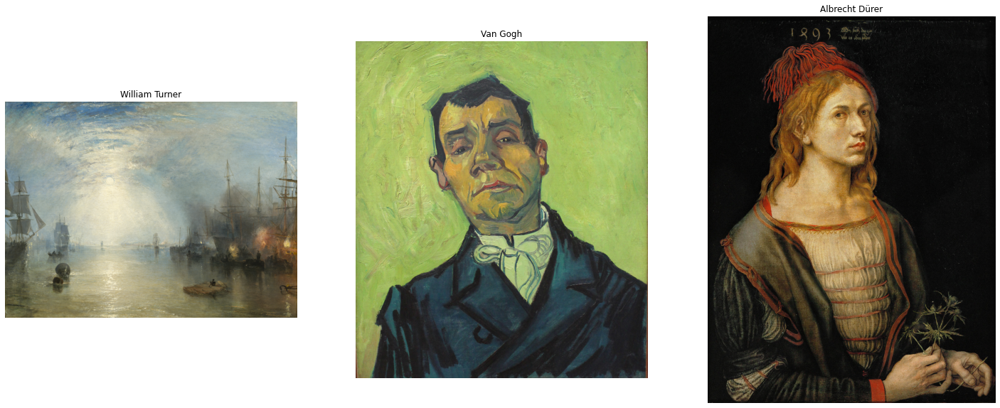

In [187]:
fig, axes = plt.subplots(1, 3, figsize=(25,10))

axes[0].imshow(plt.imread(new_img_turn))
axes[0].set_title("William Turner")
axes[0].axis('off')

axes[1].imshow(plt.imread(new_img_gogh))
axes[1].set_title("Van Gogh")
axes[1].axis('off')

axes[2].imshow(plt.imread(new_img_dure))
axes[2].set_title("Albrecht Dürer")
axes[2].axis('off')


plt.show()



In [185]:

import plotly.express as px
from skimage import io
from plotly.subplots import make_subplots
import plotly.graph_objects as go

fig = make_subplots(rows=1, cols=3)

img = io.imread(new_img_turn)
figa = px.imshow(img)

img = io.imread(new_img_gogh)
figb = px.imshow(img)
img = io.imread(new_img_dure)
figc = px.imshow(img)




figa
figb
figc

In [150]:
new_img_turn = image.load_img(new_img_turn, target_size=(128,128,3))
new_img_gogh = image.load_img(new_img_gogh, target_size=(128,128,3))
new_img_dure = image.load_img(new_img_dure, target_size=(128,128,3))

In [151]:
new_img_turn = image.img_to_array(new_img_turn)
new_img_gogh = image.img_to_array(new_img_gogh)
new_img_dure = image.img_to_array(new_img_dure)

In [152]:
new_img_turn /= 255.
new_img_gogh /= 255.
new_img_dure /= 255.

In [154]:
new_img_turn = np.reshape(new_img_turn, (1,128,128,3))
new_img_gogh = np.reshape(new_img_gogh, (1,128,128,3))
new_img_dure = np.reshape(new_img_dure, (1,128,128,3))

In [155]:
pred_turn = resnet_model.predict(new_img_turn)
pred_gogh = resnet_model.predict(new_img_gogh)
pred_dure = resnet_model.predict(new_img_dure)


In [157]:
proba_turn = np.amax(pred_turn)
proba_gogh = np.amax(pred_gogh)
proba_dure = np.amax(pred_dure)

pred_artist_turn = artists_dict_inv[np.argmax(pred_turn)]
pred_artist_gogh = artists_dict_inv[np.argmax(pred_gogh)]
pred_artist_dure = artists_dict_inv[np.argmax(pred_dure)]

In [158]:
print( f"The painting from Turner has been matched with {pred_artist_turn}")
print( f"The painting from Gogh has been matched with {pred_artist_gogh}")
print( f"The painting from Dürer has been matched with {pred_artist_dure}")

The painting from Turner has been matched with William_Turner
The painting from Gogh has been matched with Vincent_van_Gogh
The painting from Dürer has been matched with Sandro_Botticelli


ResNet misclassifies Fürer's Painting although it was already in the dataset.

## Conclusion 

This study was aiming to find an effective modelling process to predict the artists of classical paintings. A mix and variety of classical and CNN appraoches as well as different dim. reduction methods have been applied to tackle this challenge. The most promising modelling techniques were CNN approaches, namely MobileNet and ResNet50 structures with both of them scoring ~60% accuracy. 

The conventional ML-Methods had significantly less succes with the classification. Classical ML approaches can also strike higher with an extensive testing/cross-validation process; however, the imbalance between the number of paintings among different artists is undermining the micromanagement gains on the models. Presumably, the most effective appoach to inrease the accuracy of classical models would be to balance the nuber of paintings from each artist in the dataset.  